In [58]:
import pandas as pd
import numpy as np
import datetime
import matplotlib.pyplot as plt
import seaborn as sns

In [59]:
# Dataset from https://www.kaggle.com/jessemostipak/hotel-booking-demand

df = pd.read_csv('./Data/hotel_bookings.csv')

In [60]:
df

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.00,0,0,Check-Out,2015-07-01
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.00,0,0,Check-Out,2015-07-01
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,...,No Deposit,NaN,NaN,0,Transient,75.00,0,0,Check-Out,2015-07-02
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,...,No Deposit,304.0,NaN,0,Transient,75.00,0,0,Check-Out,2015-07-02
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,...,No Deposit,240.0,NaN,0,Transient,98.00,0,1,Check-Out,2015-07-03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119385,City Hotel,0,23,2017,August,35,30,2,5,2,...,No Deposit,394.0,NaN,0,Transient,96.14,0,0,Check-Out,2017-09-06
119386,City Hotel,0,102,2017,August,35,31,2,5,3,...,No Deposit,9.0,NaN,0,Transient,225.43,0,2,Check-Out,2017-09-07
119387,City Hotel,0,34,2017,August,35,31,2,5,2,...,No Deposit,9.0,NaN,0,Transient,157.71,0,4,Check-Out,2017-09-07
119388,City Hotel,0,109,2017,August,35,31,2,5,2,...,No Deposit,89.0,NaN,0,Transient,104.40,0,0,Check-Out,2017-09-07


In [61]:
df.columns

Index(['hotel', 'is_canceled', 'lead_time', 'arrival_date_year',
       'arrival_date_month', 'arrival_date_week_number',
       'arrival_date_day_of_month', 'stays_in_weekend_nights',
       'stays_in_week_nights', 'adults', 'children', 'babies', 'meal',
       'country', 'market_segment', 'distribution_channel',
       'is_repeated_guest', 'previous_cancellations',
       'previous_bookings_not_canceled', 'reserved_room_type',
       'assigned_room_type', 'booking_changes', 'deposit_type', 'agent',
       'company', 'days_in_waiting_list', 'customer_type', 'adr',
       'required_car_parking_spaces', 'total_of_special_requests',
       'reservation_status', 'reservation_status_date'],
      dtype='object')

In [62]:
df.describe()

,is_canceled,lead_time,arrival_date_year,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,agent,company,days_in_waiting_list,adr,required_car_parking_spaces,total_of_special_requests
count,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119386.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,103050.000000,6797.000000,119390.000000,119390.000000,119390.000000,119390.000000
mean,0.370416,104.011416,2016.156554,27.165173,15.798241,0.927599,2.500302,1.856403,0.103890,0.007949,0.031912,0.087118,0.137097,0.221124,86.693382,189.266735,2.321149,101.831122,0.062518,0.571363
std,0.482918,106.863097,0.707476,13.605138,8.780829,0.998613,1.908286,0.579261,0.398561,0.097436,0.175767,0.844336,1.497437,0.652306,110.774548,131.655015,17.594721,50.535790,0.245291,0.792798
min,0.000000,0.000000,2015.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,6.000000,0.000000,-6.380000,0.000000,0.000000
25%,0.000000,18.000000,2016.000000,16.000000,8.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.000000,62.000000,0.000000,69.290000,0.000000,0.000000
50%,0.000000,69.000000,2016.000000,28.000000,16.000000,1.000000,2.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,14.000000,179.000000,0.000000,94.575000,0.000000,0.000000
75%,1.000000,160.000000,2017.000000,38.000000,23.000000,2.000000,3.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,229.000000,270.000000,0.000000,126.000000,0.000000,1.000000
max,1.000000,737.000000,2017.000000,53.000000,31.000000,19.000000,50.000000,55.000000,10.000000,10.000000,1.000000,26.000000,72.000000,21.000000,535.000000,543.000000,391.000000,5400.000000,8.000000,5.000000


In [63]:
df = df.drop(['arrival_date_week_number', 'agent', 'company','reservation_status_date'], axis = 1)

In [64]:
df.children = df.children.fillna(0)
df.country = df.country.fillna(0)

In [65]:
# Adults, babies and children cant be 0 at same time, so these rows have to be dropped

ghost_filter = (df.children == 0) & (df.adults == 0) & (df.babies == 0)
df[ghost_filter]

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,...,reserved_room_type,assigned_room_type,booking_changes,deposit_type,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status
2224,Resort Hotel,0,1,2015,October,6,0,3,0,0.0,...,A,I,1,No Deposit,0,Transient-Party,0.00,0,0,Check-Out
2409,Resort Hotel,0,0,2015,October,12,0,0,0,0.0,...,A,I,0,No Deposit,0,Transient,0.00,0,0,Check-Out
3181,Resort Hotel,0,36,2015,November,20,1,2,0,0.0,...,A,C,0,No Deposit,0,Transient-Party,0.00,0,0,Check-Out
3684,Resort Hotel,0,165,2015,December,30,1,4,0,0.0,...,A,A,1,No Deposit,122,Transient-Party,0.00,0,0,Check-Out
3708,Resort Hotel,0,165,2015,December,30,2,4,0,0.0,...,A,C,1,No Deposit,122,Transient-Party,0.00,0,0,Check-Out
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115029,City Hotel,0,107,2017,June,27,0,3,0,0.0,...,A,A,1,No Deposit,0,Transient,100.80,0,0,Check-Out
115091,City Hotel,0,1,2017,June,30,0,1,0,0.0,...,E,K,0,No Deposit,0,Transient,0.00,1,1,Check-Out
116251,City Hotel,0,44,2017,July,15,1,1,0,0.0,...,A,K,2,No Deposit,0,Transient,73.80,0,0,Check-Out
116534,City Hotel,0,2,2017,July,15,2,5,0,0.0,...,A,K,1,No Deposit,0,Transient-Party,22.86,0,1,Check-Out


In [66]:
df = df[~ghost_filter]
df.reset_index(drop = True, inplace = True)

In [67]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119210 entries, 0 to 119209
Data columns (total 28 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119210 non-null  object 
 1   is_canceled                     119210 non-null  int64  
 2   lead_time                       119210 non-null  int64  
 3   arrival_date_year               119210 non-null  int64  
 4   arrival_date_month              119210 non-null  object 
 5   arrival_date_day_of_month       119210 non-null  int64  
 6   stays_in_weekend_nights         119210 non-null  int64  
 7   stays_in_week_nights            119210 non-null  int64  
 8   adults                          119210 non-null  int64  
 9   children                        119210 non-null  float64
 10  babies                          119210 non-null  int64  
 11  meal                            119210 non-null  object 
 12  country         

In [68]:
# DF IN ORIGINAL STATE

<AxesSubplot:>

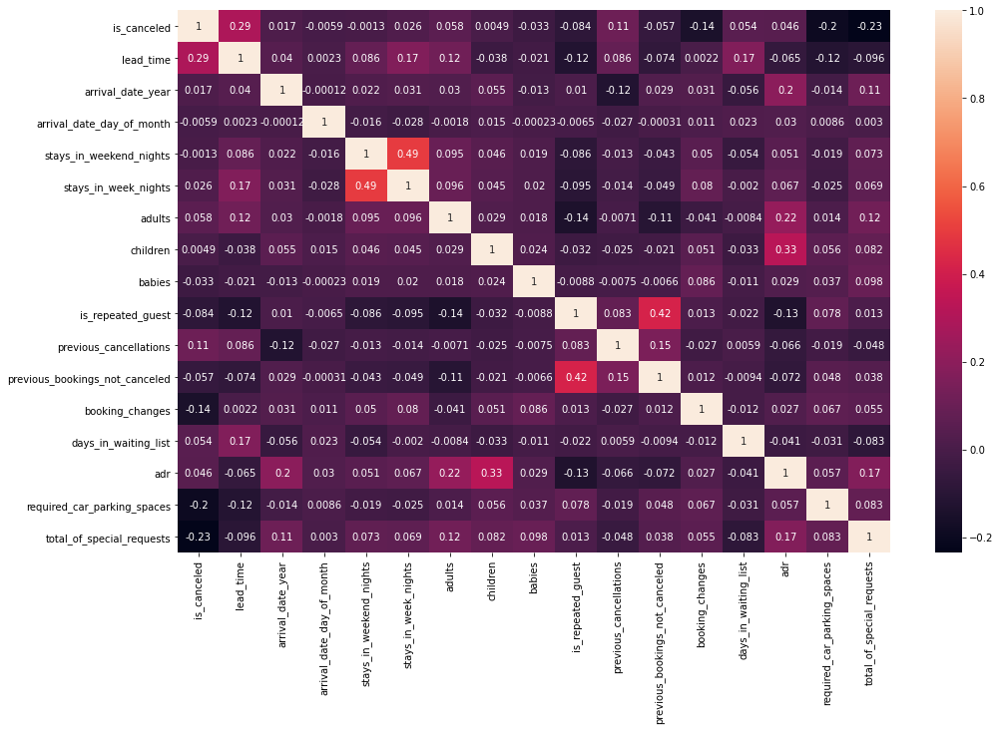

In [69]:
fig, ax = plt.subplots(figsize=(16, 10)) 
sns.heatmap(df.corr(), annot=True, ax = ax)

In [70]:
df = pd.get_dummies(df)

In [71]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119210 entries, 0 to 119209
Columns: 257 entries, is_canceled to reservation_status_No-Show
dtypes: float64(2), int64(15), uint8(240)
memory usage: 42.7 MB


In [72]:
# fig, ax = plt.subplots(figsize=(50, 50)) 
# sns.heatmap(df.corr(), annot=True, ax = ax)

In [73]:
correlation = df.corr()['is_canceled'].abs().sort_values(ascending = False)
correlation

is_canceled                     1.000000
reservation_status_Check-Out    1.000000
reservation_status_Canceled     0.978429
deposit_type_Non Refund         0.481507
deposit_type_No Deposit         0.477957
                                  ...   
country_ETH                     0.000389
country_LIE                     0.000389
country_TMP                     0.000389
country_KWT                     0.000102
country_SVK                     0.000074
Name: is_canceled, Length: 257, dtype: float64

In [74]:
# Cancellation Rate

In [75]:
# Creating df2 without countries

filter_col = [col for col in df if col.startswith('country')]
df2 = df.drop(filter_col, axis = 1)
df2

,is_canceled,lead_time,arrival_date_year,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,is_repeated_guest,...,deposit_type_No Deposit,deposit_type_Non Refund,deposit_type_Refundable,customer_type_Contract,customer_type_Group,customer_type_Transient,customer_type_Transient-Party,reservation_status_Canceled,reservation_status_Check-Out,reservation_status_No-Show
0,0,342,2015,1,0,0,2,0.0,0,0,...,1,0,0,0,0,1,0,0,1,0
1,0,737,2015,1,0,0,2,0.0,0,0,...,1,0,0,0,0,1,0,0,1,0
2,0,7,2015,1,0,1,1,0.0,0,0,...,1,0,0,0,0,1,0,0,1,0
3,0,13,2015,1,0,1,1,0.0,0,0,...,1,0,0,0,0,1,0,0,1,0
4,0,14,2015,1,0,2,2,0.0,0,0,...,1,0,0,0,0,1,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119205,0,23,2017,30,2,5,2,0.0,0,0,...,1,0,0,0,0,1,0,0,1,0
119206,0,102,2017,31,2,5,3,0.0,0,0,...,1,0,0,0,0,1,0,0,1,0
119207,0,34,2017,31,2,5,2,0.0,0,0,...,1,0,0,0,0,1,0,0,1,0
119208,0,109,2017,31,2,5,2,0.0,0,0,...,1,0,0,0,0,1,0,0,1,0


<AxesSubplot:>

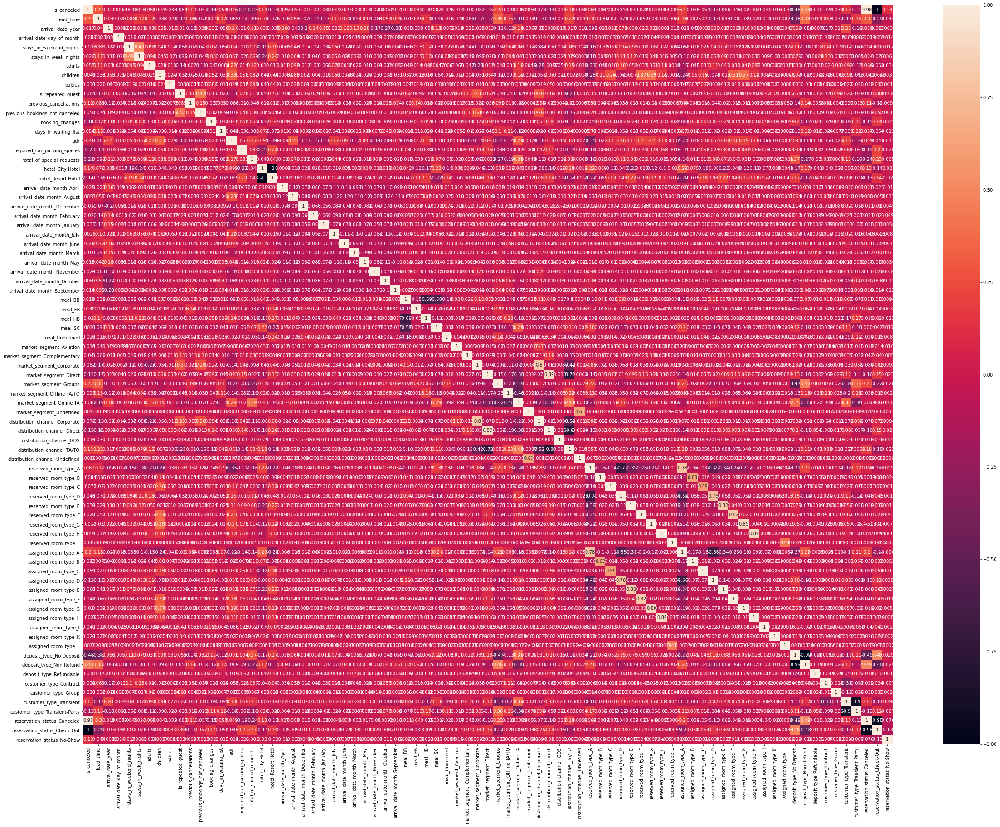

In [76]:
fig, ax = plt.subplots(figsize=(40, 30)) 
sns.heatmap(df2.corr(), annot=True, ax = ax)

In [77]:
# Creating df3 for the customer proveniences (country information) impact on cancellation rates

df3 = df.filter(like='country')
df3 = pd.concat([df3, df.is_canceled], axis = 1)
df3.head(3)

,country_0,country_ABW,country_AGO,country_AIA,country_ALB,country_AND,country_ARE,country_ARG,country_ARM,country_ASM,...,country_URY,country_USA,country_UZB,country_VEN,country_VGB,country_VNM,country_ZAF,country_ZMB,country_ZWE,is_canceled
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


<AxesSubplot:>

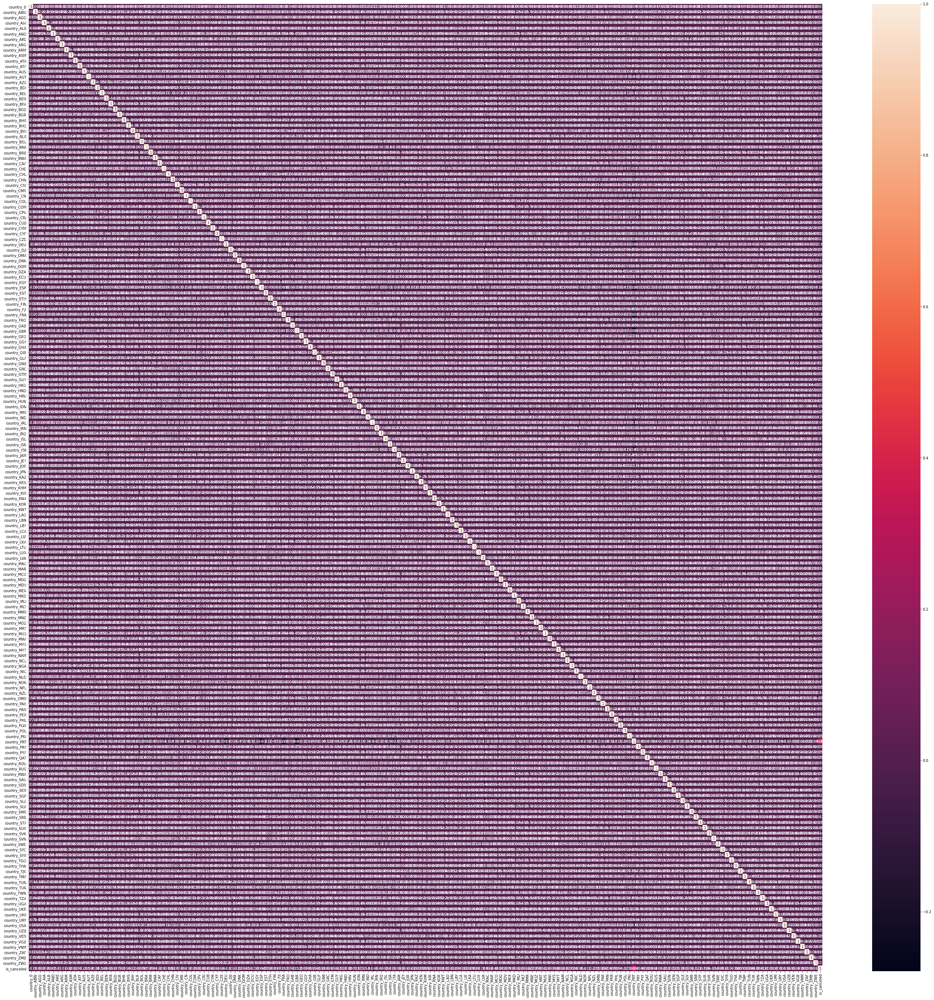

In [78]:
fig, ax = plt.subplots(figsize=(50, 50)) 
sns.heatmap(df3.corr(), annot=True, ax = ax)

In [79]:
# Obviously only "country_PRT" plays a role in cancellation rate

In [80]:
# Creating df4 with only relevant columns for prediction of cancellation

selected_cols = ('market_segment', 'distribution_channel', 'deposit_type', 'hotel')
filter_cols = [col for col in df if col.startswith(selected_cols)]
df4 = df[['is_canceled', 'lead_time', 'previous_cancellations', 'required_car_parking_spaces', 'total_of_special_requests', 'country_PRT']]
df5 = df[filter_cols]
df4 = pd.concat([df4, df5], axis = 1)

<AxesSubplot:>

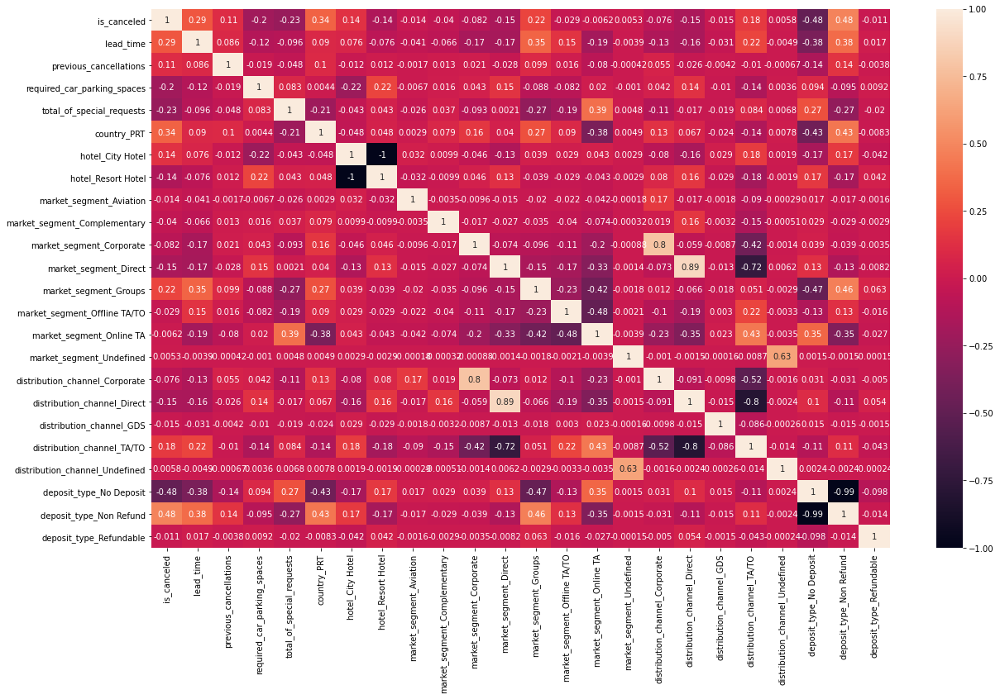

In [81]:
fig, ax = plt.subplots(figsize=(20, 12)) 
sns.heatmap(df4.corr(), annot=True, ax = ax)